<a href="https://colab.research.google.com/github/Varunsaistark/Riskdetection/blob/main/risk_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd 
import numpy as np 
!pip install --upgrade category_encoders
from category_encoders import TargetEncoder

Requirement already up-to-date: category_encoders in /usr/local/lib/python3.7/dist-packages (2.2.2)


In [ ]:
customer_df = pd.read_csv('/content/drive/MyDrive/dataset/Training Data.csv')

### Cleaning and Analyzing Data###

In [ ]:
customer_df.head(10)

,Id,income,age,experience,married,house_ownership,car_ownership,profession,city,state,current_job_years,current_house_years,risk_flag
0,1,1303835,23,3,single,rented,no,Mechanical_engineer,Rewa,Madhya_Pradesh,3,13,0
1,2,7574516,40,10,single,rented,no,Software_Developer,Parbhani,Maharashtra,9,13,0
2,3,3991815,66,4,married,rented,no,Technical_writer,Alappuzha,Kerala,4,10,0
3,4,6256451,41,2,single,rented,yes,Software_Developer,Bhubaneswar,Odisha,2,12,1
4,5,5768871,47,11,single,rented,no,Civil_servant,Tiruchirappalli[10],Tamil_Nadu,3,14,1
5,6,6915937,64,0,single,rented,no,Civil_servant,Jalgaon,Maharashtra,0,12,0
6,7,3954973,58,14,married,rented,no,Librarian,Tiruppur,Tamil_Nadu,8,12,0
7,8,1706172,33,2,single,rented,no,Economist,Jamnagar,Gujarat,2,14,0
8,9,7566849,24,17,single,rented,yes,Flight_attendant,Kota[6],Rajasthan,11,11,0
9,10,8964846,23,12,single,rented,no,Architect,Karimnagar,Telangana,5,13,0


In [ ]:
customer_df.dtypes

Id                      int64
income                  int64
age                     int64
experience              int64
married                object
house_ownership        object
car_ownership          object
profession             object
city                   object
state                  object
current_job_years       int64
current_house_years     int64
risk_flag               int64
dtype: object

In [ ]:
customer_df.shape


(252000, 13)

In [ ]:
customer_df['risk_flag'].value_counts()

0    221004
1     30996
Name: risk_flag, dtype: int64

As you can see here its **highly imbalanced** So the metric we gona choose is **Auc Roc**

In [ ]:
customer_df['house_ownership'].value_counts()

rented          231898
owned            12918
norent_noown      7184
Name: house_ownership, dtype: int64

In [ ]:
customer_df['city'].value_counts()

Vijayanagaram       1259
Bhopal              1208
Bulandshahr         1185
Saharsa[29]         1180
Vijayawada          1172
                    ... 
Ujjain               486
Warangal[11][12]     459
Bettiah[33]          457
Katni                448
Karaikudi            431
Name: city, Length: 317, dtype: int64

In [ ]:
customer_df['profession'].value_counts()

Physician                     5957
Statistician                  5806
Web_designer                  5397
Psychologist                  5390
Computer_hardware_engineer    5372
Drafter                       5359
Magistrate                    5357
Fashion_Designer              5304
Air_traffic_controller        5281
Comedian                      5259
Industrial_Engineer           5250
Mechanical_engineer           5217
Chemical_engineer             5205
Technical_writer              5195
Hotel_Manager                 5178
Financial_Analyst             5167
Graphic_Designer              5166
Flight_attendant              5128
Biomedical_Engineer           5127
Secretary                     5061
Software_Developer            5053
Petroleum_Engineer            5041
Police_officer                5035
Computer_operator             4990
Politician                    4944
Microbiologist                4881
Technician                    4864
Artist                        4861
Lawyer              

In [ ]:
customer_df['state'].value_counts()

Uttar_Pradesh        28400
Maharashtra          25562
Andhra_Pradesh       25297
West_Bengal          23483
Bihar                19780
Tamil_Nadu           16537
Madhya_Pradesh       14122
Karnataka            11855
Gujarat              11408
Rajasthan             9174
Jharkhand             8965
Haryana               7890
Telangana             7524
Assam                 7062
Kerala                5805
Delhi                 5490
Punjab                4720
Odisha                4658
Chhattisgarh          3834
Uttarakhand           1874
Jammu_and_Kashmir     1780
Puducherry            1433
Mizoram                849
Manipur                849
Himachal_Pradesh       833
Tripura                809
Uttar_Pradesh[5]       743
Chandigarh             656
Sikkim                 608
Name: state, dtype: int64

In [ ]:
customer_df.describe()

,Id,income,age,experience,current_job_years,current_house_years,risk_flag
count,252000.000000,2.520000e+05,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000
mean,126000.500000,4.997117e+06,49.954071,10.084437,6.333877,11.997794,0.123000
std,72746.278255,2.878311e+06,17.063863,6.002590,3.647053,1.399037,0.328438
min,1.000000,1.031000e+04,21.000000,0.000000,0.000000,10.000000,0.000000
25%,63000.750000,2.503015e+06,35.000000,5.000000,3.000000,11.000000,0.000000
50%,126000.500000,5.000694e+06,50.000000,10.000000,6.000000,12.000000,0.000000
75%,189000.250000,7.477502e+06,65.000000,15.000000,9.000000,13.000000,0.000000
max,252000.000000,9.999938e+06,79.000000,20.000000,14.000000,14.000000,1.000000


In [ ]:
customer_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 252000 entries, 0 to 251999
Data columns (total 13 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   Id                   252000 non-null  int64 
 1   income               252000 non-null  int64 
 2   age                  252000 non-null  int64 
 3   experience           252000 non-null  int64 
 4   married              252000 non-null  object
 5   house_ownership      252000 non-null  object
 6   car_ownership        252000 non-null  object
 7   profession           252000 non-null  object
 8   city                 252000 non-null  object
 9   state                252000 non-null  object
 10  current_job_years    252000 non-null  int64 
 11  current_house_years  252000 non-null  int64 
 12  risk_flag            252000 non-null  int64 
dtypes: int64(7), object(6)
memory usage: 25.0+ MB


In [ ]:
customer_df.isna().sum()

Id                     0
income                 0
age                    0
experience             0
married                0
house_ownership        0
car_ownership          0
profession             0
city                   0
state                  0
current_job_years      0
current_house_years    0
risk_flag              0
dtype: int64

BY the above data we can see every column is filled so there are no missing values

If there are missing values we would have either dropped the rows or replace with column mean or mode respectively

In [ ]:
customer_df.duplicated().sum()

0

So there is no duplicates too in this data set

As Id is irrelevant we are droping Id column

**Removing Id**

In [ ]:
customer_df.drop(labels='Id',axis=1,inplace=True)

**Converting categorical(nominal) data to numerical data using one hot encoding and target encoding**

In [ ]:
knn_customerdf = pd.get_dummies(customer_df,columns=customer_df.columns[3:6])

In [ ]:
knn_riskflag = knn_customerdf.pop('risk_flag')
knn_customerdf

,income,age,experience,profession,city,state,current_job_years,current_house_years,married_married,married_single,house_ownership_norent_noown,house_ownership_owned,house_ownership_rented,car_ownership_no,car_ownership_yes
0,1303835,23,3,Mechanical_engineer,Rewa,Madhya_Pradesh,3,13,0,1,0,0,1,1,0
1,7574516,40,10,Software_Developer,Parbhani,Maharashtra,9,13,0,1,0,0,1,1,0
2,3991815,66,4,Technical_writer,Alappuzha,Kerala,4,10,1,0,0,0,1,1,0
3,6256451,41,2,Software_Developer,Bhubaneswar,Odisha,2,12,0,1,0,0,1,0,1
4,5768871,47,11,Civil_servant,Tiruchirappalli[10],Tamil_Nadu,3,14,0,1,0,0,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
251995,8154883,43,13,Surgeon,Kolkata,West_Bengal,6,11,0,1,0,0,1,1,0
251996,2843572,26,10,Army_officer,Rewa,Madhya_Pradesh,6,11,0,1,0,0,1,1,0
251997,4522448,46,7,Design_Engineer,Kalyan-Dombivli,Maharashtra,7,12,0,1,0,0,1,1,0
251998,6507128,45,0,Graphic_Designer,Pondicherry,Puducherry,0,10,0,1,0,0,1,1,0


In [ ]:
target_encoder = TargetEncoder(cols='city').fit(knn_customerdf,knn_riskflag)
knn_customerdf=target_encoder.transform(knn_customerdf)


/usr/local/lib/python3.7/dist-packages/category_encoders/utils.py:21: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  elif pd.api.types.is_categorical(cols):


In [ ]:
target_encoder = TargetEncoder(cols='profession').fit(knn_customerdf,knn_riskflag)
knn_customerdf=target_encoder.transform(knn_customerdf)

/usr/local/lib/python3.7/dist-packages/category_encoders/utils.py:21: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  elif pd.api.types.is_categorical(cols):


In [ ]:
target_encoder = TargetEncoder(cols='state').fit(knn_customerdf,knn_riskflag)
knn_customerdf=target_encoder.transform(knn_customerdf)

/usr/local/lib/python3.7/dist-packages/category_encoders/utils.py:21: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  elif pd.api.types.is_categorical(cols):


In [ ]:

knndf=knn_customerdf

**Checking for outliers using box plot**

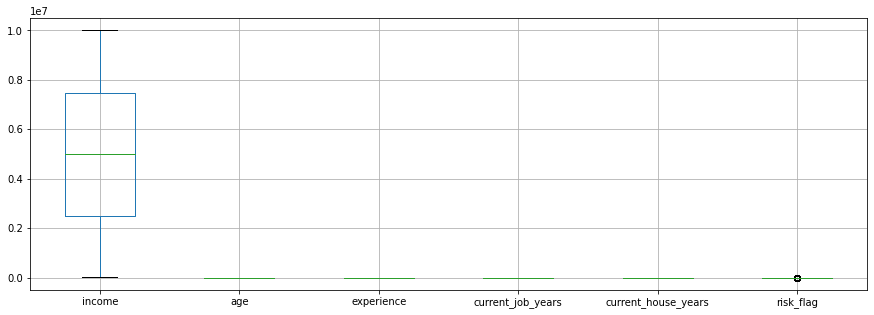

In [ ]:
customer_df.boxplot(figsize=(15,5))

**Feature scaling**

In [ ]:

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()

knndf[['income','age','experience','current_job_years','current_house_years']]=scaler.fit_transform(knndf[['income','age','experience','current_job_years','current_house_years']])
knndf


,income,age,experience,profession,city,state,current_job_years,current_house_years,married_married,married_single,house_ownership_norent_noown,house_ownership_owned,house_ownership_rented,car_ownership_no,car_ownership_yes
0,0.129487,0.034483,0.15,0.111558,0.121554,0.154369,0.214286,0.75,0,1,0,0,1,1,0
1,0.757206,0.327586,0.50,0.148427,0.122497,0.113254,0.642857,0.75,0,1,0,0,1,1,0
2,0.398564,0.775862,0.20,0.134167,0.130814,0.167097,0.285714,0.00,1,0,0,0,1,1,0
3,0.625263,0.344828,0.10,0.148427,0.326194,0.142550,0.142857,0.50,0,1,0,0,1,0,1
4,0.576454,0.448276,0.55,0.115794,0.121137,0.103163,0.214286,1.00,0,1,0,0,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
251995,0.815303,0.379310,0.65,0.115465,0.081317,0.128135,0.428571,0.25,0,1,0,0,1,1,0
251996,0.283620,0.086207,0.50,0.152113,0.121554,0.154369,0.428571,0.25,0,1,0,0,1,1,0
251997,0.451682,0.431034,0.35,0.106999,0.086370,0.113254,0.500000,0.50,0,1,0,0,1,1,0
251998,0.650356,0.413793,0.00,0.115370,0.089186,0.116539,0.000000,0.00,0,1,0,0,1,1,0


**Feature Selection**

In [ ]:
from sklearn.feature_selection import chi2
chi2(knndf,knn_riskflag)

(array([  0.40044941,  20.78250896,  53.65396745,   1.30981109,
         94.94190566,   1.87187599,  10.84908806,   1.18150368,
        100.65875681,  11.44528928,  36.69517416, 132.02022214,
         14.27384509,  43.90603128, 101.67712507]),
 array([5.26857252e-01, 5.14507240e-06, 2.39100357e-13, 2.52428862e-01,
        1.96055274e-22, 1.71260374e-01, 9.88444223e-04, 2.77050088e-01,
        1.09277484e-23, 7.16754740e-04, 1.38120934e-09, 1.48102818e-30,
        1.58045758e-04, 3.44525577e-11, 6.53506937e-24]))

Id has been removed as it doesn't contibute and all other features contribute

Cleaning and feature selection is completed

**KNN**

In [ ]:
knndf.describe()

,income,age,experience,profession,city,state,current_job_years,current_house_years,married_married,married_single,house_ownership_norent_noown,house_ownership_owned,house_ownership_rented,car_ownership_no,car_ownership_yes
count,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000
mean,0.499198,0.499208,0.504222,0.123000,0.123000,0.123000,0.452420,0.499448,0.102095,0.897905,0.028508,0.051262,0.920230,0.698413,0.301587
std,0.288130,0.294205,0.300129,0.016205,0.047284,0.017718,0.260504,0.349759,0.302774,0.302774,0.166419,0.220532,0.270937,0.458948,0.458948
min,0.000000,0.000000,0.000000,0.081486,0.026114,0.046053,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.249529,0.241379,0.250000,0.112576,0.089186,0.113254,0.214286,0.250000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000
50%,0.499557,0.500000,0.500000,0.121892,0.120301,0.117724,0.428571,0.500000,0.000000,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000
75%,0.747495,0.758621,0.750000,0.134167,0.146366,0.130586,0.642857,0.750000,0.000000,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000
max,1.000000,1.000000,1.000000,0.164052,0.326194,0.215548,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [ ]:
knndf.shape


(252000, 15)

In [ ]:
from sklearn.model_selection import train_test_split
trainval_x,test_x,trainval_y,test_y = train_test_split(knndf,knn_riskflag,test_size=0.2,stratify=knn_riskflag,random_state=120)

In [ ]:
d1_x,d3_x,d1_y,d3_y = train_test_split(knndf,knn_riskflag,test_size=0.25,stratify=knn_riskflag,random_state=10)
d1_trainx,d1_testx,d1_trainy,d1_testy = train_test_split(d1_x,d1_y,test_size=0.3,stratify=d1_y,random_state=10)
d3_trainx,d3_testx,d3_trainy,d3_testy = train_test_split(d3_x,d3_y,test_size=0.1,stratify=d3_y,random_state=10)

In [ ]:
d2_x,_,d2_y,_ = train_test_split(knndf,knn_riskflag,test_size=0.5,stratify=knn_riskflag,random_state=10)
d2_trainx,d2_testx,d2_trainy,d2_testy = train_test_split(d2_x,d2_y,test_size=0.15,stratify=d2_y,random_state=10)

In [ ]:
trainval_x.shape,trainval_y.shape

((201600, 15), (201600,))

In [ ]:
train_x,val_x,train_y,val_y = train_test_split(trainval_x,trainval_y,test_size=0.25,stratify=trainval_y,random_state=120)


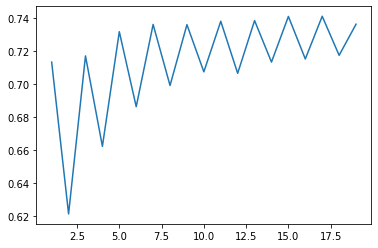

16


In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics
import matplotlib.pyplot as plt

k_range=[i for i in range(1,22)]
scores=[]

for i in k_range:
  model = KNeighborsClassifier(n_neighbors=i)
  model.fit(train_x,train_y)
  y_pred = model.predict(val_x)
  scores.append(metrics.roc_auc_score(val_y,y_pred))

plt.plot(k_range,scores)
plt.show()

print(scores.index(max(scores)))


In [ ]:
k=scores.index(max(scores))
model_t = KNeighborsClassifier(n_neighbors=k)
model_t.fit(trainval_x,trainval_y)
from sklearn import metrics
test_pred = model_t.predict(test_x)
metrics.roc_auc_score(test_y,test_pred)

0.7191258009763645

Now lets do cross validation for more accuracy in knn

[0.7081491452591633, 0.7977655681390702, 0.8394217033773842, 0.860035276510458, 0.8725313770143922, 0.8798290783637294, 0.8840062575522033, 0.8867980562466397, 0.8885509957933252, 0.8893954611323963, 0.8900944854319868, 0.8906605892281669, 0.890926098389107, 0.8911974716419678, 0.8915664520429594, 0.8916722989993868, 0.8917968673386548, 0.8918012126627757, 0.8917373246059075, 0.8915570865908528, 0.8910581717880997, 0.8903953996572561, 0.8892603097479848, 0.8873979915559099, 0.8850049570080204, 0.8818889944953835, 0.8793950914904638, 0.8765006171340811, 0.8742967170197871]


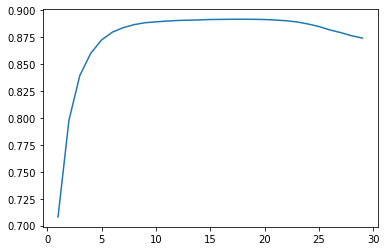

In [ ]:
from sklearn.model_selection import cross_val_score
k_range=[i for i in range(1,23)]
scores=[]

for i in k_range:
  model = KNeighborsClassifier(n_neighbors=i)
  score= cross_val_score(model,trainval_x,trainval_y,cv=5,scoring='roc_auc')
  scores.append(score.mean())
print(scores)

plt.plot(k_range,scores)
plt.show()


In [ ]:
k=scores.index(max(scores))

model_t = KNeighborsClassifier(n_neighbors=k)
model_t.fit(trainval_x,trainval_y)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=17, p=2,
                     weights='uniform')

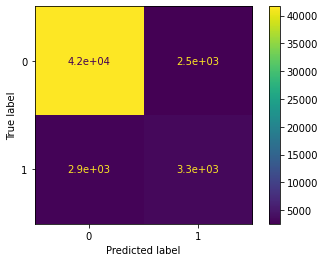

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = model_t.predict(test_x)

l = confusion_matrix(test_y,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=model_t.classes_)
disp.plot()

In [ ]:
metrics.roc_auc_score(test_y,test_pred)

0.7384753514152281

Have used k value as 17 which seems the best for genralising from graph above

**Q4**

In [ ]:
model_t = KNeighborsClassifier(n_neighbors=17)
model_t.fit(d1_trainx,d1_trainy)


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=17, p=2,
                     weights='uniform')

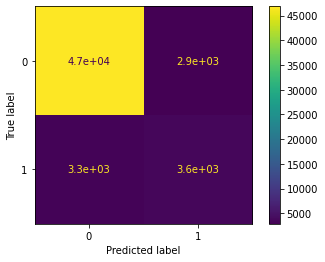

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = model_t.predict(d1_testx)

l = confusion_matrix(d1_testy,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=model_t.classes_)
disp.plot()

In [ ]:
metrics.accuracy_score(d1_testy,test_pred)

0.8903174603174603

In [ ]:
model_t = KNeighborsClassifier(n_neighbors=17)
model_t.fit(d2_trainx,d2_trainy)


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=17, p=2,
                     weights='uniform')

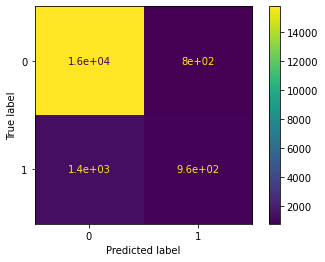

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = model_t.predict(d2_testx)

l = confusion_matrix(d2_testy,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=model_t.classes_)
disp.plot()

In [ ]:
metrics.accuracy_score(d2_testy,test_pred)

0.8855555555555555

In [ ]:
model_t = KNeighborsClassifier(n_neighbors=17)
model_t.fit(d3_trainx,d3_trainy)


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=17, p=2,
                     weights='uniform')

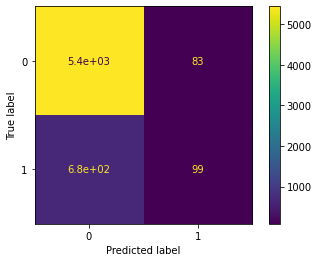

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = model_t.predict(d3_testx)

l = confusion_matrix(d3_testy,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=model_t.classes_)
disp.plot()

In [ ]:
metrics.accuracy_score(d3_testy,test_pred)

0.8795238095238095

**Decision trees**

In [ ]:
from sklearn.tree import DecisionTreeClassifier
classifier = DecisionTreeClassifier()
classifier.fit(trainval_x,trainval_y)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

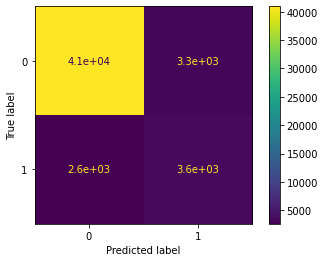

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = classifier.predict(test_x)

l = confusion_matrix(test_y,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=classifier.classes_)
disp.plot()

In [ ]:
metrics.roc_auc_score(test_y,test_pred)

0.7508307010563087

In [ ]:
from sklearn.tree import export_graphviz
from six import StringIO
from IPython.display import Image
import pydotplus

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.0939079 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.0939079 to fit



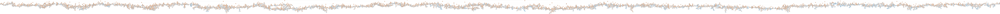

In [ ]:
dot_data = StringIO()
export_graphviz(classifier,out_file=dot_data,filled=True,rounded=True,special_characters=True,
                )
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('fraud.png')
Image(graph.create_png())

**Q4**

In [ ]:
from sklearn.tree import DecisionTreeClassifier
classifier = DecisionTreeClassifier()
classifier.fit(d1_trainx,d1_trainy)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

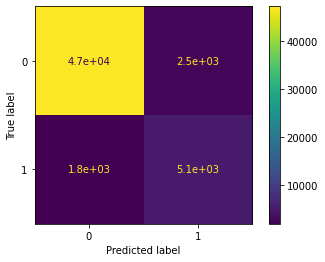

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = classifier.predict(d1_testx)

l = confusion_matrix(d1_testy,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=classifier.classes_)
disp.plot()

In [ ]:
metrics.roc_auc_score(d1_testy,test_pred)

0.7355168497152754

In [ ]:
from sklearn.tree import DecisionTreeClassifier
classifier = DecisionTreeClassifier()
classifier.fit(d2_trainx,d2_trainy)

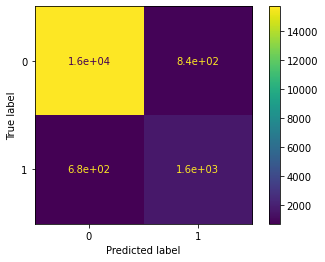

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = classifier.predict(d2_testx)

l = confusion_matrix(d2_testy,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=classifier.classes_)
disp.plot()

In [ ]:
metrics.roc_auc_score(d2_testy,test_pred)

0.8278995767041308

In [ ]:
from sklearn.tree import DecisionTreeClassifier
classifier = DecisionTreeClassifier()
classifier.fit(d3_trainx,d3_trainy)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

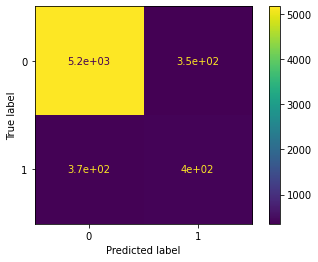

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = classifier.predict(d3_testx)

l = confusion_matrix(d3_testy,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=model_t.classes_)
disp.plot()

In [ ]:
metrics.roc_auc_score(d3_testy,test_pred)

0.7270354692745585

**Naives Bayes Classifier**

In [ ]:
from sklearn.naive_bayes import GaussianNB
gnclf = GaussianNB()
gnclf.fit(trainval_x,trainval_y)


GaussianNB(priors=None, var_smoothing=1e-09)

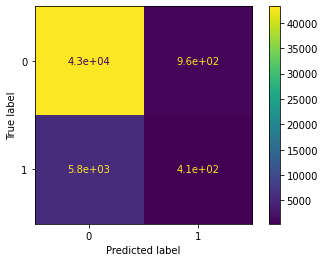

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = gnclf.predict(test_x)

l = confusion_matrix(test_y,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=model_t.classes_)
disp.plot()

In [ ]:
metrics.roc_auc_score(test_y,test_pred)

0.5219442942823203

**Q4**

In [ ]:
from sklearn.naive_bayes import GaussianNB
gnclf = GaussianNB()
gnclf.fit(d1_trainx,d1_trainy)


GaussianNB(priors=None, var_smoothing=1e-09)

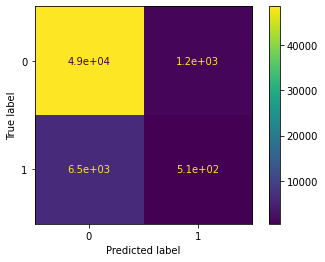

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = gnclf.predict(d1_testx)

l = confusion_matrix(d1_testy,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=model_t.classes_)
disp.plot()

In [ ]:
metrics.roc_auc_score(d1_testy,test_pred)

0.5245839370671843

In [ ]:
from sklearn.naive_bayes import GaussianNB
gnclf = GaussianNB()
gnclf.fit(d2_trainx,d2_trainy)


GaussianNB(priors=None, var_smoothing=1e-09)

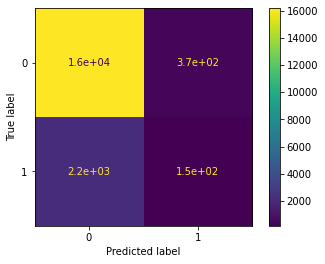

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = gnclf.predict(d2_testx)

l = confusion_matrix(d2_testy,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=model_t.classes_)
disp.plot()

In [ ]:
metrics.roc_auc_score(d2_testy,test_pred)

0.5212513988225563

In [ ]:
from sklearn.naive_bayes import GaussianNB
gnclf = GaussianNB()
gnclf.fit(d3_trainx,d3_trainy)


GaussianNB(priors=None, var_smoothing=1e-09)

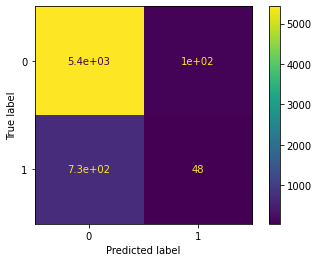

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = gnclf.predict(d3_testx)

l = confusion_matrix(d3_testy,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=model_t.classes_)
disp.plot()

In [ ]:
metrics.roc_auc_score(d3_testy,test_pred)

0.5219179681798278

**Tensorflow keras**

In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import metrics
#train_y = np.asarray(train_y).astype('float32').reshape((-1,1))
#val_y= np.asarray(val_y).astype('float32').reshape((-1,1))
#test_y= np.asarray(test_y).astype('float32').reshape((-1,1))
model1=keras.Sequential([
    keras.layers.Dense(15,input_shape=(15,), activation='relu'),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(1024, activation='relu'),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

tb_callback = tf.keras.callbacks.TensorBoard(log_dir="logs/",histogram_freq=1)
model1.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[tf.keras.metrics.AUC()])
model1.fit(train_x, train_y,validation_data=(val_x,val_y) , epochs=120, callbacks=[tb_callback], batch_size=16384, verbose=2)


Epoch 1/120
10/10 - 19s - loss: 0.4407 - auc_2: 0.5088 - val_loss: 0.3845 - val_auc_2: 0.5154
Epoch 2/120
10/10 - 18s - loss: 0.3799 - auc_2: 0.5175 - val_loss: 0.3778 - val_auc_2: 0.5287
Epoch 3/120
10/10 - 18s - loss: 0.3736 - auc_2: 0.5355 - val_loss: 0.3723 - val_auc_2: 0.5440
Epoch 4/120
10/10 - 18s - loss: 0.3717 - auc_2: 0.5517 - val_loss: 0.3721 - val_auc_2: 0.5495
Epoch 5/120
10/10 - 18s - loss: 0.3710 - auc_2: 0.5557 - val_loss: 0.3714 - val_auc_2: 0.5543
Epoch 6/120
10/10 - 18s - loss: 0.3707 - auc_2: 0.5584 - val_loss: 0.3706 - val_auc_2: 0.5584
Epoch 7/120
10/10 - 18s - loss: 0.3701 - auc_2: 0.5634 - val_loss: 0.3701 - val_auc_2: 0.5625
Epoch 8/120
10/10 - 18s - loss: 0.3699 - auc_2: 0.5671 - val_loss: 0.3698 - val_auc_2: 0.5671
Epoch 9/120
10/10 - 18s - loss: 0.3693 - auc_2: 0.5722 - val_loss: 0.3693 - val_auc_2: 0.5727
Epoch 10/120
10/10 - 18s - loss: 0.3687 - auc_2: 0.5797 - val_loss: 0.3688 - val_auc_2: 0.5804
Epoch 11/120
10/10 - 18s - loss: 0.3682 - auc_2: 0.5843 - v

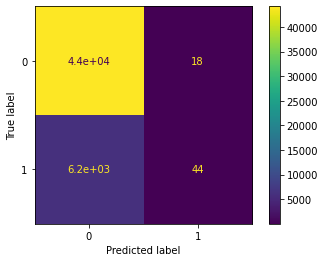

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = model1.predict(test_x)
for i in range(len(test_pred)):
  if test_pred[i]>=0.5:
    test_pred[i]=1
  else:
    test_pred[i]=0
l = confusion_matrix(test_y,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=['0','1'])
disp.plot()

In [ ]:
metrics.roc_auc_score(test_y,test_pred)

0.5033453442067771

**Q2**

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import metrics
#train_y = np.asarray(train_y).astype('float32').reshape((-1,1))
#val_y= np.asarray(val_y).astype('float32').reshape((-1,1))
#test_y= np.asarray(test_y).astype('float32').reshape((-1,1))
model=keras.Sequential([
    keras.layers.Dense(15,input_shape=(15,), activation='relu'),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(1024, activation='relu'),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

tb_callback = tf.keras.callbacks.TensorBoard(log_dir="logs1/",histogram_freq=1)
model.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[tf.keras.metrics.AUC()])
model.fit(train_x, train_y,validation_data=(val_x,val_y) , epochs=10, callbacks=[tb_callback], batch_size=16384, verbose=2)


Epoch 1/10
10/10 - 20s - loss: 0.4507 - auc_3: 0.5066 - val_loss: 0.3771 - val_auc_3: 0.5199
Epoch 2/10
10/10 - 19s - loss: 0.3826 - auc_3: 0.5195 - val_loss: 0.3798 - val_auc_3: 0.5268
Epoch 3/10
10/10 - 19s - loss: 0.3773 - auc_3: 0.5218 - val_loss: 0.3761 - val_auc_3: 0.5354
Epoch 4/10
10/10 - 18s - loss: 0.3736 - auc_3: 0.5325 - val_loss: 0.3727 - val_auc_3: 0.5454
Epoch 5/10
10/10 - 19s - loss: 0.3719 - auc_3: 0.5460 - val_loss: 0.3709 - val_auc_3: 0.5595
Epoch 6/10
10/10 - 19s - loss: 0.3705 - auc_3: 0.5640 - val_loss: 0.3701 - val_auc_3: 0.5774
Epoch 7/10
10/10 - 19s - loss: 0.3693 - auc_3: 0.5820 - val_loss: 0.3687 - val_auc_3: 0.5876
Epoch 8/10
10/10 - 19s - loss: 0.3683 - auc_3: 0.5915 - val_loss: 0.3679 - val_auc_3: 0.5931
Epoch 9/10
10/10 - 18s - loss: 0.3673 - auc_3: 0.5978 - val_loss: 0.3665 - val_auc_3: 0.6009
Epoch 10/10
10/10 - 18s - loss: 0.3662 - auc_3: 0.6062 - val_loss: 0.3656 - val_auc_3: 0.6075


In [ ]:
model.evaluate(test_x,test_y)

1575/1575 [==============================] - 8s 5ms/step - loss: 0.3728 - auc_4: 0.5000


[0.37284737825393677, 0.5]

In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import metrics
#train_y = np.asarray(train_y).astype('float32').reshape((-1,1))
#val_y= np.asarray(val_y).astype('float32').reshape((-1,1))
#test_y= np.asarray(test_y).astype('float32').reshape((-1,1))
model=keras.Sequential([
    keras.layers.Dense(15,input_shape=(15,), activation='sigmoid'),
    keras.layers.Dense(512, activation='sigmoid'),
    keras.layers.Dense(1024, activation='sigmoid'),
    keras.layers.Dense(512, activation='sigmoid'),
    keras.layers.Dense(1, activation='sigmoid')
])

#tb_callback = tf.keras.callbacks.TensorBoard(log_dir="logs1/",histogram_freq=1)
model.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[tf.keras.metrics.AUC()])
model.fit(train_x, train_y,validation_data=(val_x,val_y) , epochs=10, callbacks=[tb_callback], batch_size=16384, verbose=2)


Epoch 1/10
10/10 - 20s - loss: 0.6785 - auc_4: 0.5022 - val_loss: 0.3882 - val_auc_4: 0.5000
Epoch 2/10
10/10 - 19s - loss: 0.4186 - auc_4: 0.4981 - val_loss: 0.3908 - val_auc_4: 0.5000
Epoch 3/10
10/10 - 19s - loss: 0.3956 - auc_4: 0.5005 - val_loss: 0.3750 - val_auc_4: 0.5000
Epoch 4/10
10/10 - 19s - loss: 0.3794 - auc_4: 0.4984 - val_loss: 0.3745 - val_auc_4: 0.5000
Epoch 5/10
10/10 - 19s - loss: 0.3753 - auc_4: 0.5045 - val_loss: 0.3736 - val_auc_4: 0.5039
Epoch 6/10
10/10 - 19s - loss: 0.3740 - auc_4: 0.4971 - val_loss: 0.3734 - val_auc_4: 0.5000
Epoch 7/10
10/10 - 19s - loss: 0.3732 - auc_4: 0.4999 - val_loss: 0.3730 - val_auc_4: 0.5000
Epoch 8/10
10/10 - 18s - loss: 0.3729 - auc_4: 0.5032 - val_loss: 0.3730 - val_auc_4: 0.5000
Epoch 9/10
10/10 - 18s - loss: 0.3729 - auc_4: 0.4989 - val_loss: 0.3729 - val_auc_4: 0.5000
Epoch 10/10
10/10 - 18s - loss: 0.3729 - auc_4: 0.4980 - val_loss: 0.3728 - val_auc_4: 0.5000


In [ ]:
model.evaluate(test_x,test_y)

1575/1575 [==============================] - 8s 5ms/step - loss: 0.3728 - auc_4: 0.5000


[0.37284737825393677, 0.5]

In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import metrics
#train_y = np.asarray(train_y).astype('float32').reshape((-1,1))
#val_y= np.asarray(val_y).astype('float32').reshape((-1,1))
#test_y= np.asarray(test_y).astype('float32').reshape((-1,1))
model=keras.Sequential([
    keras.layers.Dense(15,input_shape=(15,), activation='tanh'),
    keras.layers.Dense(512, activation='tanh'),
    keras.layers.Dense(1024, activation='tanh'),
    keras.layers.Dense(512, activation='tanh'),
    keras.layers.Dense(1, activation='sigmoid')
])

#tb_callback = tf.keras.callbacks.TensorBoard(log_dir="logs1/",histogram_freq=1)
model.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[tf.keras.metrics.AUC()])
model.fit(train_x, train_y,validation_data=(val_x,val_y) , epochs=10, callbacks=[tb_callback], batch_size=16384, verbose=2)


Epoch 1/10
10/10 - 20s - loss: 0.4772 - auc_5: 0.5010 - val_loss: 0.4204 - val_auc_5: 0.5314
Epoch 2/10
10/10 - 19s - loss: 0.3892 - auc_5: 0.5189 - val_loss: 0.3858 - val_auc_5: 0.5480
Epoch 3/10
10/10 - 19s - loss: 0.3759 - auc_5: 0.5366 - val_loss: 0.3699 - val_auc_5: 0.5663
Epoch 4/10
10/10 - 19s - loss: 0.3707 - auc_5: 0.5615 - val_loss: 0.3709 - val_auc_5: 0.5717
Epoch 5/10
10/10 - 19s - loss: 0.3698 - auc_5: 0.5670 - val_loss: 0.3689 - val_auc_5: 0.5778
Epoch 6/10
10/10 - 19s - loss: 0.3689 - auc_5: 0.5786 - val_loss: 0.3688 - val_auc_5: 0.5820
Epoch 7/10
10/10 - 19s - loss: 0.3685 - auc_5: 0.5826 - val_loss: 0.3680 - val_auc_5: 0.5906
Epoch 8/10
10/10 - 19s - loss: 0.3680 - auc_5: 0.5874 - val_loss: 0.3676 - val_auc_5: 0.5944
Epoch 9/10
10/10 - 19s - loss: 0.3677 - auc_5: 0.5890 - val_loss: 0.3674 - val_auc_5: 0.5955
Epoch 10/10
10/10 - 19s - loss: 0.3671 - auc_5: 0.5949 - val_loss: 0.3667 - val_auc_5: 0.6022


In [ ]:
model.evaluate(test_x,test_y)

1575/1575 [==============================] - 9s 5ms/step - loss: 0.3669 - auc_5: 0.6003


[0.3669015169143677, 0.6002839207649231]

Inference is almost 3 activation functions performance is same in this case for auc_roc score tanh worked a little bit well but genrally in small neural networks activation functions doesn't make much difference but as we go on to bigger networks there comes vanishing gradient and all so there based on the data we have to choose. but for smaller its enough that its non linear and saturated thats the main purpose here 

**Q3**

In [ ]:
y=[]
x=[1,2,3,4,5,6,7]

In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import metrics

model=keras.Sequential([
    keras.layers.Dense(15,input_shape=(15,), activation='relu'),
    keras.layers.Dense(1, activation='relu'),
    keras.layers.Dense(2, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

model.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[tf.keras.metrics.AUC()])
model.fit(train_x, train_y,validation_data=(val_x,val_y) , epochs=10, batch_size=16384, verbose=2)

Epoch 1/10
10/10 - 2s - loss: 0.7111 - auc_13: 0.5052 - val_loss: 0.6992 - val_auc_13: 0.5059
Epoch 2/10
10/10 - 1s - loss: 0.6936 - auc_13: 0.5041 - val_loss: 0.6876 - val_auc_13: 0.5053
Epoch 3/10
10/10 - 1s - loss: 0.6852 - auc_13: 0.5021 - val_loss: 0.6824 - val_auc_13: 0.5001
Epoch 4/10
10/10 - 1s - loss: 0.6807 - auc_13: 0.5020 - val_loss: 0.6785 - val_auc_13: 0.5008
Epoch 5/10
10/10 - 1s - loss: 0.6770 - auc_13: 0.5007 - val_loss: 0.6748 - val_auc_13: 0.4995
Epoch 6/10
10/10 - 1s - loss: 0.6734 - auc_13: 0.5021 - val_loss: 0.6713 - val_auc_13: 0.4995
Epoch 7/10
10/10 - 1s - loss: 0.6698 - auc_13: 0.5006 - val_loss: 0.6677 - val_auc_13: 0.5004
Epoch 8/10
10/10 - 1s - loss: 0.6663 - auc_13: 0.4988 - val_loss: 0.6642 - val_auc_13: 0.5002
Epoch 9/10
10/10 - 1s - loss: 0.6628 - auc_13: 0.5006 - val_loss: 0.6608 - val_auc_13: 0.5002
Epoch 10/10
10/10 - 1s - loss: 0.6593 - auc_13: 0.5022 - val_loss: 0.6573 - val_auc_13: 0.5003


In [ ]:
score = model.evaluate(test_x,test_y)
y.append(1-score[1])


1575/1575 [==============================] - 3s 2ms/step - loss: 0.6573 - auc_13: 0.5008


In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import metrics

model=keras.Sequential([
    keras.layers.Dense(15,input_shape=(15,), activation='relu'),
    keras.layers.Dense(2, activation='relu'),
    keras.layers.Dense(4, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

model.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[tf.keras.metrics.AUC()])
model.fit(train_x, train_y,validation_data=(val_x,val_y) , epochs=10, batch_size=16384, verbose=2)

Epoch 1/10
10/10 - 2s - loss: 0.6915 - auc_14: 0.5001 - val_loss: 0.6890 - val_auc_14: 0.5000
Epoch 2/10
10/10 - 1s - loss: 0.6872 - auc_14: 0.5000 - val_loss: 0.6847 - val_auc_14: 0.5000
Epoch 3/10
10/10 - 1s - loss: 0.6829 - auc_14: 0.4985 - val_loss: 0.6804 - val_auc_14: 0.5000
Epoch 4/10
10/10 - 1s - loss: 0.6785 - auc_14: 0.5000 - val_loss: 0.6758 - val_auc_14: 0.5015
Epoch 5/10
10/10 - 1s - loss: 0.6736 - auc_14: 0.4998 - val_loss: 0.6701 - val_auc_14: 0.5000
Epoch 6/10
10/10 - 1s - loss: 0.6671 - auc_14: 0.4969 - val_loss: 0.6622 - val_auc_14: 0.5021
Epoch 7/10
10/10 - 1s - loss: 0.6579 - auc_14: 0.4979 - val_loss: 0.6513 - val_auc_14: 0.4961
Epoch 8/10
10/10 - 1s - loss: 0.6459 - auc_14: 0.5037 - val_loss: 0.6377 - val_auc_14: 0.5018
Epoch 9/10
10/10 - 1s - loss: 0.6313 - auc_14: 0.5033 - val_loss: 0.6215 - val_auc_14: 0.4999
Epoch 10/10
10/10 - 1s - loss: 0.6138 - auc_14: 0.5070 - val_loss: 0.6024 - val_auc_14: 0.5024


In [ ]:
score = model.evaluate(test_x,test_y)
y.append(1-score[1])


1575/1575 [==============================] - 3s 2ms/step - loss: 0.6024 - auc_14: 0.5058


In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import metrics
#train_y = np.asarray(train_y).astype('float32').reshape((-1,1))
#val_y= np.asarray(val_y).astype('float32').reshape((-1,1))
#test_y= np.asarray(test_y).astype('float32').reshape((-1,1))
model=keras.Sequential([
    keras.layers.Dense(15,input_shape=(15,), activation='relu'),
    keras.layers.Dense(3, activation='relu'),
    keras.layers.Dense(6, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

model.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[tf.keras.metrics.AUC()])
model.fit(train_x, train_y,validation_data=(val_x,val_y) , epochs=10, batch_size=16384, verbose=2)

Epoch 1/10
10/10 - 2s - loss: 0.6682 - auc_15: 0.5236 - val_loss: 0.6557 - val_auc_15: 0.5248
Epoch 2/10
10/10 - 1s - loss: 0.6465 - auc_15: 0.5267 - val_loss: 0.6329 - val_auc_15: 0.5301
Epoch 3/10
10/10 - 1s - loss: 0.6212 - auc_15: 0.5323 - val_loss: 0.6020 - val_auc_15: 0.5417
Epoch 4/10
10/10 - 1s - loss: 0.5856 - auc_15: 0.5377 - val_loss: 0.5613 - val_auc_15: 0.5420
Epoch 5/10
10/10 - 1s - loss: 0.5428 - auc_15: 0.5431 - val_loss: 0.5161 - val_auc_15: 0.5390
Epoch 6/10
10/10 - 1s - loss: 0.4949 - auc_15: 0.5353 - val_loss: 0.4640 - val_auc_15: 0.5336
Epoch 7/10
10/10 - 1s - loss: 0.4432 - auc_15: 0.5306 - val_loss: 0.4174 - val_auc_15: 0.5269
Epoch 8/10
10/10 - 1s - loss: 0.4038 - auc_15: 0.5262 - val_loss: 0.3889 - val_auc_15: 0.5222
Epoch 9/10
10/10 - 1s - loss: 0.3827 - auc_15: 0.5241 - val_loss: 0.3772 - val_auc_15: 0.5209
Epoch 10/10
10/10 - 1s - loss: 0.3756 - auc_15: 0.5231 - val_loss: 0.3748 - val_auc_15: 0.5208


In [ ]:
score = model.evaluate(test_x,test_y)
y.append(1-score[1])


1575/1575 [==============================] - 3s 2ms/step - loss: 0.3748 - auc_15: 0.5217


In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import metrics
#train_y = np.asarray(train_y).astype('float32').reshape((-1,1))
#val_y= np.asarray(val_y).astype('float32').reshape((-1,1))
#test_y= np.asarray(test_y).astype('float32').reshape((-1,1))
model=keras.Sequential([
    keras.layers.Dense(15,input_shape=(15,), activation='relu'),
    keras.layers.Dense(4, activation='relu'),
    keras.layers.Dense(8, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

model.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[tf.keras.metrics.AUC()])
model.fit(train_x, train_y,validation_data=(val_x,val_y) , epochs=10, batch_size=16384, verbose=2)

Epoch 1/10
10/10 - 2s - loss: 0.7207 - auc_16: 0.5152 - val_loss: 0.6980 - val_auc_16: 0.5175
Epoch 2/10
10/10 - 1s - loss: 0.6858 - auc_16: 0.5004 - val_loss: 0.6730 - val_auc_16: 0.4815
Epoch 3/10
10/10 - 1s - loss: 0.6675 - auc_16: 0.4812 - val_loss: 0.6583 - val_auc_16: 0.4827
Epoch 4/10
10/10 - 1s - loss: 0.6504 - auc_16: 0.4793 - val_loss: 0.6384 - val_auc_16: 0.4815
Epoch 5/10
10/10 - 1s - loss: 0.6290 - auc_16: 0.4772 - val_loss: 0.6139 - val_auc_16: 0.4794
Epoch 6/10
10/10 - 1s - loss: 0.6014 - auc_16: 0.4770 - val_loss: 0.5816 - val_auc_16: 0.4782
Epoch 7/10
10/10 - 1s - loss: 0.5650 - auc_16: 0.4794 - val_loss: 0.5390 - val_auc_16: 0.4798
Epoch 8/10
10/10 - 1s - loss: 0.5189 - auc_16: 0.4794 - val_loss: 0.4894 - val_auc_16: 0.4821
Epoch 9/10
10/10 - 1s - loss: 0.4695 - auc_16: 0.4827 - val_loss: 0.4425 - val_auc_16: 0.4839
Epoch 10/10
10/10 - 1s - loss: 0.4264 - auc_16: 0.4853 - val_loss: 0.4067 - val_auc_16: 0.4855


In [ ]:
score = model.evaluate(test_x,test_y)
y.append(1-score[1])


1575/1575 [==============================] - 3s 2ms/step - loss: 0.4069 - auc_16: 0.4864


In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import metrics
#train_y = np.asarray(train_y).astype('float32').reshape((-1,1))
#val_y= np.asarray(val_y).astype('float32').reshape((-1,1))
#test_y= np.asarray(test_y).astype('float32').reshape((-1,1))
model=keras.Sequential([
    keras.layers.Dense(15,input_shape=(15,), activation='relu'),
    keras.layers.Dense(5, activation='relu'),
    keras.layers.Dense(10, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

model.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[tf.keras.metrics.AUC()])
model.fit(train_x, train_y,validation_data=(val_x,val_y) , epochs=10, batch_size=16384, verbose=2)

Epoch 1/10
10/10 - 2s - loss: 0.6545 - auc_17: 0.5102 - val_loss: 0.6284 - val_auc_17: 0.5090
Epoch 2/10
10/10 - 1s - loss: 0.6114 - auc_17: 0.5038 - val_loss: 0.5858 - val_auc_17: 0.5029
Epoch 3/10
10/10 - 1s - loss: 0.5665 - auc_17: 0.4998 - val_loss: 0.5376 - val_auc_17: 0.5012
Epoch 4/10
10/10 - 1s - loss: 0.5168 - auc_17: 0.4997 - val_loss: 0.4868 - val_auc_17: 0.5000
Epoch 5/10
10/10 - 1s - loss: 0.4669 - auc_17: 0.4984 - val_loss: 0.4402 - val_auc_17: 0.4989
Epoch 6/10
10/10 - 1s - loss: 0.4244 - auc_17: 0.5011 - val_loss: 0.4049 - val_auc_17: 0.5008
Epoch 7/10
10/10 - 1s - loss: 0.3950 - auc_17: 0.5040 - val_loss: 0.3842 - val_auc_17: 0.5046
Epoch 8/10
10/10 - 1s - loss: 0.3798 - auc_17: 0.5091 - val_loss: 0.3760 - val_auc_17: 0.5065
Epoch 9/10
10/10 - 1s - loss: 0.3749 - auc_17: 0.5107 - val_loss: 0.3744 - val_auc_17: 0.5087
Epoch 10/10
10/10 - 1s - loss: 0.3741 - auc_17: 0.5140 - val_loss: 0.3742 - val_auc_17: 0.5107


In [ ]:
score = model.evaluate(test_x,test_y)
y.append(1-score[1])


1575/1575 [==============================] - 3s 2ms/step - loss: 0.3741 - auc_17: 0.5139


In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import metrics
#train_y = np.asarray(train_y).astype('float32').reshape((-1,1))
#val_y= np.asarray(val_y).astype('float32').reshape((-1,1))
#test_y= np.asarray(test_y).astype('float32').reshape((-1,1))
model=keras.Sequential([
    keras.layers.Dense(15,input_shape=(15,), activation='relu'),
    keras.layers.Dense(6, activation='relu'),
    keras.layers.Dense(12, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

model.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[tf.keras.metrics.AUC()])
model.fit(train_x, train_y,validation_data=(val_x,val_y) , epochs=10, batch_size=16384, verbose=2)

Epoch 1/10
10/10 - 2s - loss: 0.6280 - auc_18: 0.5016 - val_loss: 0.5966 - val_auc_18: 0.5005
Epoch 2/10
10/10 - 1s - loss: 0.5749 - auc_18: 0.5033 - val_loss: 0.5445 - val_auc_18: 0.5006
Epoch 3/10
10/10 - 1s - loss: 0.5233 - auc_18: 0.5054 - val_loss: 0.4945 - val_auc_18: 0.5013
Epoch 4/10
10/10 - 1s - loss: 0.4752 - auc_18: 0.5050 - val_loss: 0.4499 - val_auc_18: 0.5017
Epoch 5/10
10/10 - 1s - loss: 0.4342 - auc_18: 0.5044 - val_loss: 0.4146 - val_auc_18: 0.5025
Epoch 6/10
10/10 - 1s - loss: 0.4036 - auc_18: 0.5064 - val_loss: 0.3912 - val_auc_18: 0.5044
Epoch 7/10
10/10 - 1s - loss: 0.3850 - auc_18: 0.5092 - val_loss: 0.3793 - val_auc_18: 0.5077
Epoch 8/10
10/10 - 1s - loss: 0.3776 - auc_18: 0.5119 - val_loss: 0.3775 - val_auc_18: 0.5098
Epoch 9/10
10/10 - 1s - loss: 0.3771 - auc_18: 0.5145 - val_loss: 0.3774 - val_auc_18: 0.5111
Epoch 10/10
10/10 - 1s - loss: 0.3766 - auc_18: 0.5162 - val_loss: 0.3766 - val_auc_18: 0.5124


In [ ]:
score = model.evaluate(test_x,test_y)
y.append(1-score[1])


1575/1575 [==============================] - 3s 2ms/step - loss: 0.3764 - auc_18: 0.5155


In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import metrics
#train_y = np.asarray(train_y).astype('float32').reshape((-1,1))
#val_y= np.asarray(val_y).astype('float32').reshape((-1,1))
#test_y= np.asarray(test_y).astype('float32').reshape((-1,1))
model=keras.Sequential([
    keras.layers.Dense(15,input_shape=(15,), activation='relu'),
    keras.layers.Dense(7, activation='relu'),
    keras.layers.Dense(14, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

model.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[tf.keras.metrics.AUC()])
model.fit(train_x, train_y,validation_data=(val_x,val_y) , epochs=10, batch_size=16384, verbose=2)

Epoch 1/10
10/10 - 2s - loss: 0.6993 - auc_19: 0.4905 - val_loss: 0.6765 - val_auc_19: 0.4986
Epoch 2/10
10/10 - 1s - loss: 0.6592 - auc_19: 0.5041 - val_loss: 0.6315 - val_auc_19: 0.5045
Epoch 3/10
10/10 - 1s - loss: 0.6081 - auc_19: 0.5111 - val_loss: 0.5727 - val_auc_19: 0.5102
Epoch 4/10
10/10 - 1s - loss: 0.5458 - auc_19: 0.5146 - val_loss: 0.5081 - val_auc_19: 0.5121
Epoch 5/10
10/10 - 1s - loss: 0.4821 - auc_19: 0.5162 - val_loss: 0.4485 - val_auc_19: 0.5143
Epoch 6/10
10/10 - 1s - loss: 0.4284 - auc_19: 0.5179 - val_loss: 0.4056 - val_auc_19: 0.5151
Epoch 7/10
10/10 - 1s - loss: 0.3941 - auc_19: 0.5203 - val_loss: 0.3840 - val_auc_19: 0.5152
Epoch 8/10
10/10 - 1s - loss: 0.3798 - auc_19: 0.5199 - val_loss: 0.3780 - val_auc_19: 0.5152
Epoch 9/10
10/10 - 1s - loss: 0.3768 - auc_19: 0.5220 - val_loss: 0.3776 - val_auc_19: 0.5147
Epoch 10/10
10/10 - 1s - loss: 0.3766 - auc_19: 0.5222 - val_loss: 0.3772 - val_auc_19: 0.5171


In [ ]:
score = model.evaluate(test_x,test_y)
y.append(1-score[1])


1575/1575 [==============================] - 3s 2ms/step - loss: 0.3766 - auc_19: 0.5234


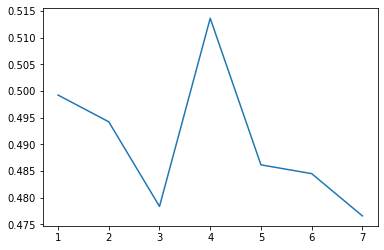

In [ ]:
import matplotlib.pyplot as plt

plt.plot(x,y)

The inference that can be taken is as the number of units increase the test score has been increased for the same number of epochs and the lesser epochs it takes to acheive good score and less loss given good amount of data if data is less it can lead to over fitting when we increase too much of hidden units and train for more epochs

**Q4**

In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import metrics
#train_y = np.asarray(train_y).astype('float32').reshape((-1,1))
#val_y= np.asarray(val_y).astype('float32').reshape((-1,1))
#test_y= np.asarray(test_y).astype('float32').reshape((-1,1))
model=keras.Sequential([
    keras.layers.Dense(15,input_shape=(15,), activation='relu'),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(1024, activation='relu'),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])


model.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[tf.keras.metrics.AUC()])
model.fit(d1_trainx,d1_trainy, epochs=120, batch_size=16384, verbose=2)


In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = model.predict(d1_testy)

l = confusion_matrix(d1_testy,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=model_t.classes_)
disp.plot()

In [ ]:
metrics.auc_roc_score(d1_testy,test_pred)

In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import metrics
#train_y = np.asarray(train_y).astype('float32').reshape((-1,1))
#val_y= np.asarray(val_y).astype('float32').reshape((-1,1))
#test_y= np.asarray(test_y).astype('float32').reshape((-1,1))
model=keras.Sequential([
    keras.layers.Dense(15,input_shape=(15,), activation='relu'),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(1024, activation='relu'),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])


model.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[tf.keras.metrics.AUC()])
model.fit(d2_trainx,d2_trainy, epochs=120, batch_size=16384, verbose=2)


In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = model.predict(d2_testy)

l = confusion_matrix(d2_testy,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=model_t.classes_)
disp.plot()

In [ ]:
metrics.auc_roc_score(d2_testy,test_pred)

In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import metrics
#train_y = np.asarray(train_y).astype('float32').reshape((-1,1))
#val_y= np.asarray(val_y).astype('float32').reshape((-1,1))
#test_y= np.asarray(test_y).astype('float32').reshape((-1,1))
model=keras.Sequential([
    keras.layers.Dense(15,input_shape=(15,), activation='relu'),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(1024, activation='relu'),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])


model.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[tf.keras.metrics.AUC()])
model.fit(d3_trainx,d3_trainy, epochs=120, batch_size=16384, verbose=2)


In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

test_pred = model.predict(d3_testy)

l = confusion_matrix(d3_testy,test_pred)
disp = ConfusionMatrixDisplay(l,display_labels=model_t.classes_)
disp.plot()

In [ ]:
metrics.auc_roc_score(d3_testy,test_pred)

Inference that can be drawn is performance is not much affected in other algorithms as they are able to do well with less data too but Ann struggles a bit for less data

**Neural networks Tabnet**

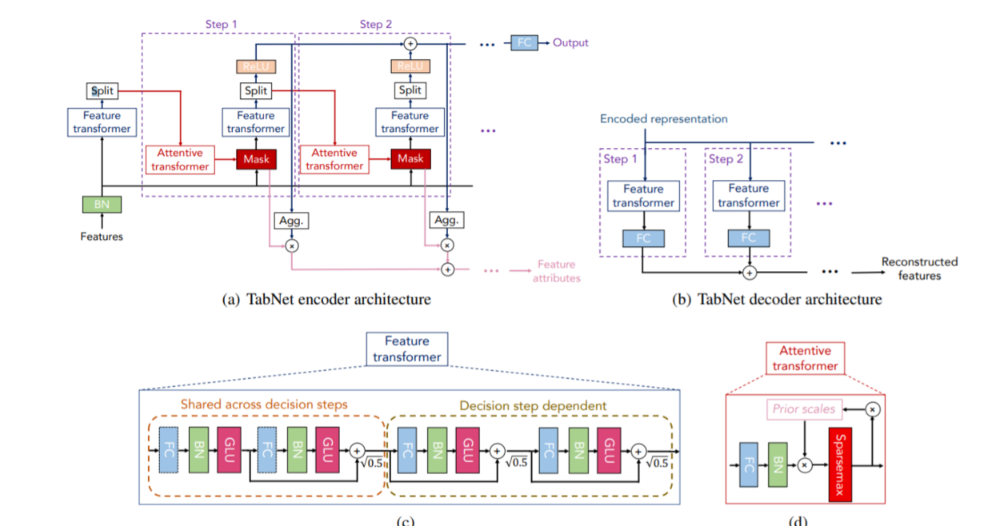

In [ ]:
import pandas as pd 
!pip install pytorch-tabnet

In [ ]:
from pytorch_tabnet.tab_model import TabNetClassifier
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
train=pd.read_csv('/content/drive/MyDrive/dataset/Training Data.csv')
train.drop(labels='Id',axis=1,inplace=True)
total_y = train.pop('risk_flag')

train[['income']] = scaler.fit_transform(train[['income']])
test = pd.read_csv('/content/drive/MyDrive/dataset/Test Data.csv')

test.drop(labels='id',axis=1,inplace=True)
test[['income']] = scaler.transform(test[['income']])


In [ ]:
from sklearn.preprocessing import LabelEncoder
categorical_columns = []
categorical_dims =  {}
for col in train.columns[train.dtypes == object]:
    print(col, train[col].nunique())
    l_enc = LabelEncoder()
    train[col] = train[col].fillna("VV_likely")
    train[col] = [i.replace('_',' ') for i in train[col]]
    test[col] = [i.replace('_',' ') for i in test[col]]
    train[col] = l_enc.fit_transform(train[col].values)
    test[col] = l_enc.transform(test[col].values)
    categorical_columns.append(col)
    categorical_dims[col] = len(l_enc.classes_)



married 2
house_ownership 3
car_ownership 2
profession 51
city 317
state 29


In [ ]:
unused_feat = []
target="risk_flag"
features = [ col for col in train.columns if col not in unused_feat+[target]] 

cat_idxs = [ i for i, f in enumerate(features) if f in categorical_columns]

cat_dims = [ categorical_dims[f] for i, f in enumerate(features) if f in categorical_columns]

In [ ]:
from sklearn.model_selection import train_test_split
from pytorch_tabnet.metrics import Metric
from sklearn.metrics import roc_auc_score
class mymetric(Metric):
  def __init__(self):
    self._name="score"
    self._maximize=True
  def __call__(self,y_true,y_score):
    auc_roc = roc_auc_score(y_true,y_score[:,1])
    return 2*auc_roc

train_x,val_x,train_y,val_y = train_test_split(train,total_y,test_size=0.005,stratify=total_y,random_state=120)
model=TabNetClassifier(cat_dims=cat_dims,cat_emb_dim=5,cat_idxs=cat_idxs)
model.fit(train.values,total_y,
          eval_set=[(train_x.values,train_y),(val_x.values,val_y)],
          eval_name=['train','val'],
          eval_metric = ["score",mymetric],
          max_epochs=200,
          patience=50,
          batch_size=16384,
          virtual_batch_size=256
          )


Device used : cpu


**pytorch**

In [ ]:
print(test['city'])
y_riskflag = model.predict(test.values)

0        181
1        131
2        290
3        171
4         39
        ... 
27995     90
27996    249
27997    190
27998     47
27999    212
Name: city, Length: 28000, dtype: int64


In [ ]:
from sklearn import metrics
y_risk = model.predict(train.values)
metrics.roc_auc_score(total_y,y_risk)

NameError: ignored

In [ ]:
sub=pd.DataFrame()
sub['id'] = range(1,28001)
sub['risk_flag']=y_riskflag

In [ ]:
sub.to_csv('/content/drive/MyDrive/dataset/sub.csv',index=False)